# <a name=''>**Import My Dataset:**</a>
💡[**EMNIST Dataset**](https://pytorch.org/vision/main/generated/torchvision.datasets.EMNIST.html)

In [ ]:
import os
import torch
import torchvision
import numpy as np
import pandas as pd
from termcolor import colored
import matplotlib.pyplot as plt
from torchvision import transforms as T
from torch.utils.data import Dataset, DataLoader

In [ ]:
T_composed = T.Compose([T.ToTensor()])
print(f'\nTransforms: {T_composed}\n')


Transforms: Compose(
    ToTensor()
)



In [ ]:
EMNIST_dataset = torchvision.datasets.EMNIST(root='./data/EMNIST', split='letters', download=True, train=True, transform=T_composed)

print(f'\n{colored("Shape of EMNIST_dataset:", "blue", attrs=["bold"])} {colored(EMNIST_dataset.data.shape, attrs=["bold"])}')
print(f'\n{colored(" ... and its Data Type:", "blue", attrs=["bold"])} {colored(EMNIST_dataset.data.dtype, attrs=["bold"])}\n')

100%|██████████| 561753746/561753746 [00:04<00:00, 113981666.78it/s]


Extracting ./data/EMNIST/EMNIST/raw/gzip.zip to ./data/EMNIST/EMNIST/raw

Shape of EMNIST_dataset: torch.Size([124800, 28, 28])

 ... and its Data Type: torch.uint8



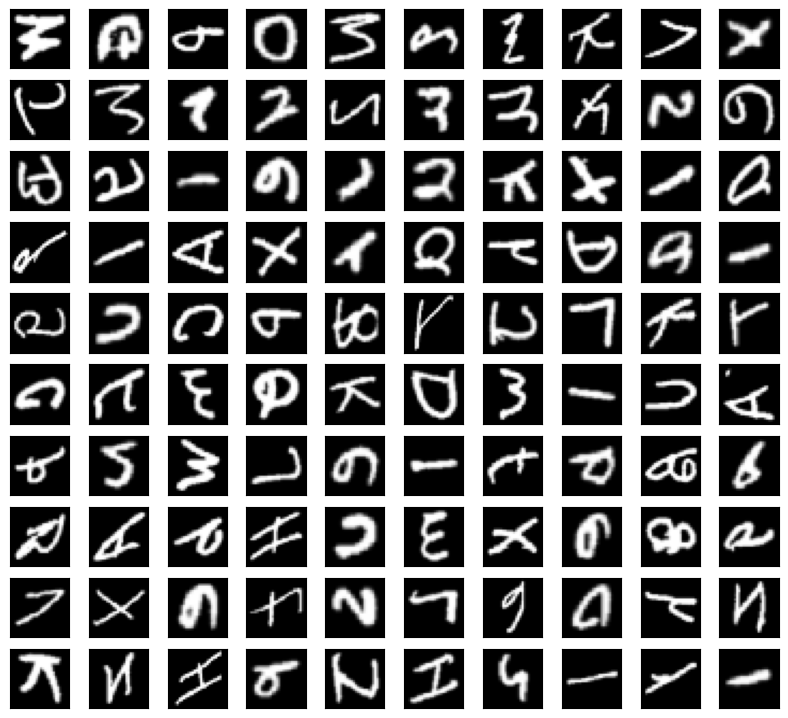

In [ ]:
def plot_images(dataset, num_samples=100, cols=10):
    ''' Plots some samples from the dataset '''
    plt.figure(figsize=(10, 10)) 
    for i, img in enumerate(dataset.data):
        if i == num_samples:
            break
        plt.subplot(int(num_samples/cols) + 1, cols, i + 1)
        plt.imshow(img, cmap='gray'), plt.xticks([]), plt.yticks([])

plot_images(EMNIST_dataset)

In [ ]:
BATCH_SIZE = 128
torch.manual_seed(0)
loader = DataLoader(EMNIST_dataset, batch_size=BATCH_SIZE, shuffle=True)

print(f'\nShape of Images: {loader.dataset.data.shape}')
print(f'\nLength of Loader: {len(loader)}\n')


Shape of Images: torch.Size([124800, 28, 28])

Length of Loader: 975



In [ ]:
unique_labels_list = list(np.unique(EMNIST_dataset.targets))
print(f'\nUnique Labels: {unique_labels_list}\n')


Unique Labels: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26]



# <a name=''>**Generating images with DDPMs: A PyTorch Implementation**</a>

 💡[**Main Article**](https://arxiv.org/pdf/2006.11239.pdf)

# <a name=''>**Installatins**</a>

In [ ]:
!pip3 install --upgrade pip
!pip3 install einops

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 4.3 MB/s eta 0:00:00


# <a name=''>**Imports and Definitions**</a>

In [ ]:
import random
import imageio
from argparse import ArgumentParser

from tqdm.auto import tqdm

import einops
import torch.nn as nn
from torch.optim import Adam

from torchvision.transforms import Compose, ToTensor, Lambda

SEED = 0
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)

## Execution options

Here's a few options you should set:

 - `no_train` specifies whether you want to skip the training loop and just use a pre-trained model. If you haven't trained a model already using this notebook, keep this as `False`. If you want to use a pre-trained model, load it in the colab filesystem.

- `fashion` specifies whether you want to use the Fashion-MNIST dataset (`True`) or not and use the MNIST dataset instead (`False`).

- `batch_size`, `n_epochs` and `lr` are your typical training hyper-parameters. Notice that `lr=0.001` is the hyper-parameter used by the authors.


In [ ]:
no_train = False
fashion = True
#######################
# batch_size = 128
batch_size = BATCH_SIZE
# n_epochs = 20
n_epochs = 30
# lr = 0.001
lr = 0.0001
#######################

In [ ]:
store_path = "ddpm_fashion.pt" if fashion else "ddpm_mnist.pt"

# <a name=''>**Utility functions**</a>


In [ ]:
def show_images(images, title=""):
    """Shows the provided images as sub-pictures in a square"""

    if type(images) is torch.Tensor:
        images = images.detach().cpu().numpy()

    fig = plt.figure(figsize=(15, 10))
    cols = 10
    rows = 10
    idx = 0
    for r in range(rows):
        for c in range(cols):
            fig.add_subplot(rows, cols, idx + 1)

            if idx < len(images):
                plt.imshow(images[idx][0], cmap="gray"), plt.xticks([]), plt.yticks([])
                idx += 1
    fig.suptitle(f'\n\n{title}\n', fontsize=15, fontweight='bold')

    plt.show()

## <a name=''>**Getting device**</a>

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}\t" + (f"{torch.cuda.get_device_name(0)}" if torch.cuda.is_available() else "CPU"))

Using device: cuda	Tesla T4


# <a name=''>**Defining the DDPM module**</a>

We now proceed and define a DDPM PyTorch module. Since in principle the DDPM scheme is independent of the model architecture used in each denoising step, we define a high-level model that is constructed using a `network` parameter, as well as:

- `n_steps`: number of diffusion steps $T$;
- `min_beta`: value of the first $\beta_t$ ($\beta_1$);
- `max_beta`: value of the last  $\beta_t$ ($\beta_T$);
- `device`: device onto which the model is run;
- `image_chw`: tuple contining dimensionality of images.

The `forward` process of DDPMs benefits from a nice property: We don't actually need to slowly add noise step-by-step, but we can directly skip to whathever step $t$ we want using coefficients $\alpha_bar$.

For the `backward` method instead, we simply let the network do the job.

Note that in this implementation, $t$ is assumed to be a `(N, 1)` tensor, where `N` is the number of images in tensor `x`. We thus support different time-steps for multiple images.

In [ ]:
class MyDDPM(nn.Module):
    def __init__(self, network, n_steps=200, min_beta=10 ** -4, max_beta=0.02, device=None, image_chw=(1, 28, 28)):
        super(MyDDPM, self).__init__()
        self.n_steps = n_steps
        self.device = device
        self.image_chw = image_chw
        self.network = network.to(device)
        self.betas = torch.linspace(min_beta, max_beta, n_steps).to(
            device)  # Number of steps is typically in the order of thousands
        self.alphas = 1 - self.betas
        self.alpha_bars = torch.tensor([torch.prod(self.alphas[:i + 1]) for i in range(len(self.alphas))]).to(device)

    def forward(self, x0, t, eta=None):
        # Make input image more noisy (we can directly skip to the desired step)
        n, c, h, w = x0.shape
        a_bar = self.alpha_bars[t]

        if eta is None:
            eta = torch.randn(n, c, h, w).to(self.device)

        noisy = a_bar.sqrt().reshape(n, 1, 1, 1) * x0 + (1 - a_bar).sqrt().reshape(n, 1, 1, 1) * eta
        return noisy

    def backward(self, x, t):
        # Run each image through the network for each timestep t in the vector t.
        # The network returns its estimation of the noise that was added.
        return self.network(x, t)

## Visualizing forward and backward

Now that we have defined the high-level functioning of a DDPM model, we can already define some related utility functions.

In particular, we will be showing the forward process (which is independent of the denoising network) with the `show_forward` method. 

We run the backward pass and generate new images with the `generate_new_images` method, but this time we will put more effort into the function and also make it such that a GIF image is created. Notice that in the paper (https://arxiv.org/pdf/2006.11239.pdf) by Ho et. al., two options are considered for $\sigma_t^2$:

- $\sigma_t^2$ = $\beta_t$
- $\sigma_t^2$ = $\frac{1 - \bar{\alpha_{t-1}}}{1 - \bar{\alpha_{t}}} \beta_t$

In this implementation, they are both a few line-comments away. However, the two terms are rougly always the same and little difference is noticeable. By default, I choose the first option out of simplicity.

In [ ]:
def show_forward(ddpm, loader, device):
    # Showing the forward process
    for batch in loader:
        imgs = batch[0]

        show_images(imgs, "Original images")

        for percent in [0.25, 0.5, 0.75, 1]:
            show_images(
                ddpm(imgs.to(device),
                     [int(percent * ddpm.n_steps) - 1 for _ in range(len(imgs))]),
                f"DDPM Noisy images {int(percent * 100)}%"
            )
        break

In [ ]:
def generate_new_images(ddpm, n_samples=16, device=None, frames_per_gif=100, gif_name="sampling.gif", c=1, h=28, w=28):

    """Given a DDPM model, a number of samples to be generated and a device, returns some newly generated samples"""
    frame_idxs = np.linspace(0, ddpm.n_steps, frames_per_gif).astype(np.uint)
    frames = []

    with torch.no_grad():
        if device is None:
            device = ddpm.device

        # Starting from random noise
        x = torch.randn(n_samples, c, h, w).to(device)

        for idx, t in enumerate(list(range(ddpm.n_steps))[::-1]):
            # Estimating noise to be removed
            time_tensor = (torch.ones(n_samples, 1) * t).to(device).long()
            eta_theta = ddpm.backward(x, time_tensor)

            alpha_t = ddpm.alphas[t]
            alpha_t_bar = ddpm.alpha_bars[t]

            # Partially denoising the image
            x = (1 / alpha_t.sqrt()) * (x - (1 - alpha_t) / (1 - alpha_t_bar).sqrt() * eta_theta)

            if t > 0:
                z = torch.randn(n_samples, c, h, w).to(device)

                # Option 1: sigma_t squared = beta_t
                beta_t = ddpm.betas[t]
                sigma_t = beta_t.sqrt()

                # Option 2: sigma_t squared = beta_tilda_t
                # prev_alpha_t_bar = ddpm.alpha_bars[t-1] if t > 0 else ddpm.alphas[0]
                # beta_tilda_t = ((1 - prev_alpha_t_bar)/(1 - alpha_t_bar)) * beta_t
                # sigma_t = beta_tilda_t.sqrt()

                # Adding some more noise like in Langevin Dynamics fashion
                x = x + sigma_t * z

            # Adding frames to the GIF
            if idx in frame_idxs or t == 0:
                # Putting digits in range [0, 255]
                normalized = x.clone()
                for i in range(len(normalized)):
                    normalized[i] -= torch.min(normalized[i])
                    normalized[i] *= 255 / torch.max(normalized[i])

                # Reshaping batch (n, c, h, w) to be a (as much as it gets) square frame
                frame = einops.rearrange(normalized, "(b1 b2) c h w -> (b1 h) (b2 w) c", b1=int(n_samples ** 0.5))
                frame = frame.cpu().numpy().astype(np.uint8)

                # Rendering frame
                frames.append(frame)

    # Storing the gif
    with imageio.get_writer(gif_name, mode="I") as writer:
        for idx, frame in enumerate(frames):
            writer.append_data(frame)
            if idx == len(frames) - 1:
                for _ in range(frames_per_gif // 3):
                    writer.append_data(frames[-1])
    return x

# UNet architecture

Okay great! All that concerns DDPM is down on the table already. So now we simply define an architecture that will be responsible of denoising the we should be good to go... Not so fast! While in principle that's true, we have to be careful to conditioning our model with the temporal information. 

Remember that the only term of the loss function that we really care about is $||\epsilon - \epsilon_\theta(\sqrt{\bar{\alpha}_t}x_0 + \sqrt{1 - \bar{\alpha}_t}\epsilon, t)||^2$, where $\epsilon$ is some random noise and $\epsilon_\theta$ is the model's prediction of the noise. Now, $\epsilon_\theta$ is a function of both $x$ and $t$ and we don't want to have a distinct model for each denoising step (thousands of independent models), but instead we want to use a single model that takes as input the image $x$ and the scalar value indicating the timestep $t$.

To do so, in practice we use a sinusoidal embedding (function `sinusoidal_embedding`) that maps each time-step to a `time_emb_dim` dimension. These time embeddings are further mapped with some time-embedding MLPs (function `_make_te`) and added to tensors through the network in a channel-wise manner.

> <span style='color: red'>**NOTE:**</span> This UNet architecture is purely arbitrary and was desined to work with `28x28` spatial resolution images.

In [ ]:
def sinusoidal_embedding(n, d):
    # Returns the standard positional embedding
    embedding = torch.zeros(n, d)
    wk = torch.tensor([1 / 10_000 ** (2 * j / d) for j in range(d)])
    wk = wk.reshape((1, d))
    t = torch.arange(n).reshape((n, 1))
    embedding[:,::2] = torch.sin(t * wk[:,::2])
    embedding[:,1::2] = torch.cos(t * wk[:,::2])

    return embedding

In [ ]:
class MyBlock(nn.Module):
    def __init__(self, shape, in_c, out_c, kernel_size=3, stride=1, padding=1, activation=None, normalize=True):
        super(MyBlock, self).__init__()
        self.ln = nn.LayerNorm(shape)
        self.conv1 = nn.Conv2d(in_c, out_c, kernel_size, stride, padding)
        self.conv2 = nn.Conv2d(out_c, out_c, kernel_size, stride, padding)
        self.activation = nn.SiLU() if activation is None else activation
        self.normalize = normalize

    def forward(self, x):
        out = self.ln(x) if self.normalize else x
        out = self.conv1(out)
        out = self.activation(out)
        out = self.conv2(out)
        out = self.activation(out)
        return out

In [ ]:
class MyUNet(nn.Module):
    def __init__(self, n_steps=1000, time_emb_dim=100):
        super(MyUNet, self).__init__()

        # Sinusoidal embedding
        self.time_embed = nn.Embedding(n_steps, time_emb_dim)
        self.time_embed.weight.data = sinusoidal_embedding(n_steps, time_emb_dim)
        self.time_embed.requires_grad_(False)

        # First half
        self.te1 = self._make_te(time_emb_dim, 1)
        self.b1 = nn.Sequential(
            MyBlock((1, 28, 28), 1, 10),
            MyBlock((10, 28, 28), 10, 10),
            MyBlock((10, 28, 28), 10, 10)
        )
        self.down1 = nn.Conv2d(10, 10, 4, 2, 1)  # d_out = (d_in / 2)

        self.te2 = self._make_te(time_emb_dim, 10)
        self.b2 = nn.Sequential(
            MyBlock((10, 14, 14), 10, 20),
            MyBlock((20, 14, 14), 20, 20),
            MyBlock((20, 14, 14), 20, 20)
        )
        self.down2 = nn.Conv2d(20, 20, 4, 2, 1)  # d_out = (d_in / 2)

        self.te3 = self._make_te(time_emb_dim, 20)
        self.b3 = nn.Sequential(
            MyBlock((20, 7, 7), 20, 40),
            MyBlock((40, 7, 7), 40, 40),
            MyBlock((40, 7, 7), 40, 40)
        )
        self.down3 = nn.Sequential(
            nn.Conv2d(40, 40, 2, 1),
            nn.SiLU(),
            nn.Conv2d(40, 40, 4, 2, 1)
        )

        # Bottleneck
        self.te_mid = self._make_te(time_emb_dim, 40)
        self.b_mid = nn.Sequential(
            MyBlock((40, 3, 3), 40, 20),
            MyBlock((20, 3, 3), 20, 20),
            MyBlock((20, 3, 3), 20, 40)
        )

        # Second half
        self.up1 = nn.Sequential(
            nn.ConvTranspose2d(40, 40, 4, 2, 1),
            nn.SiLU(),
            nn.ConvTranspose2d(40, 40, 2, 1)
        )

        self.te4 = self._make_te(time_emb_dim, 80)
        self.b4 = nn.Sequential(
            MyBlock((80, 7, 7), 80, 40),
            MyBlock((40, 7, 7), 40, 20),
            MyBlock((20, 7, 7), 20, 20)
        )

        self.up2 = nn.ConvTranspose2d(20, 20, 4, 2, 1)
        self.te5 = self._make_te(time_emb_dim, 40)
        self.b5 = nn.Sequential(
            MyBlock((40, 14, 14), 40, 20),
            MyBlock((20, 14, 14), 20, 10),
            MyBlock((10, 14, 14), 10, 10)
        )

        self.up3 = nn.ConvTranspose2d(10, 10, 4, 2, 1)
        self.te_out = self._make_te(time_emb_dim, 20)
        self.b_out = nn.Sequential(
            MyBlock((20, 28, 28), 20, 10),
            MyBlock((10, 28, 28), 10, 10),
            MyBlock((10, 28, 28), 10, 10, normalize=False)
        )

        self.conv_out = nn.Conv2d(10, 1, 3, 1, 1)

    def forward(self, x, t):
        # x is (N, 2, 28, 28) (image with positional embedding stacked on channel dimension)
        t = self.time_embed(t)
        n = len(x)
        out1 = self.b1(x + self.te1(t).reshape(n, -1, 1, 1))  # (N, 10, 28, 28)
        out2 = self.b2(self.down1(out1) + self.te2(t).reshape(n, -1, 1, 1))  # (N, 20, 14, 14)
        out3 = self.b3(self.down2(out2) + self.te3(t).reshape(n, -1, 1, 1))  # (N, 40, 7, 7)

        out_mid = self.b_mid(self.down3(out3) + self.te_mid(t).reshape(n, -1, 1, 1))  # (N, 40, 3, 3)

        out4 = torch.cat((out3, self.up1(out_mid)), dim=1)  # (N, 80, 7, 7)
        out4 = self.b4(out4 + self.te4(t).reshape(n, -1, 1, 1))  # (N, 20, 7, 7)

        out5 = torch.cat((out2, self.up2(out4)), dim=1)  # (N, 40, 14, 14)
        out5 = self.b5(out5 + self.te5(t).reshape(n, -1, 1, 1))  # (N, 10, 14, 14)

        out = torch.cat((out1, self.up3(out5)), dim=1)  # (N, 20, 28, 28)
        out = self.b_out(out + self.te_out(t).reshape(n, -1, 1, 1))  # (N, 1, 28, 28)

        out = self.conv_out(out)

        return out

    def _make_te(self, dim_in, dim_out):
        return nn.Sequential(
            nn.Linear(dim_in, dim_out),
            nn.SiLU(),
            nn.Linear(dim_out, dim_out)
        )

# <a name=''>**Instantiating the model**</a>

In [ ]:
n_steps, min_beta, max_beta = 1000, 10 ** -4, 0.02  # Originally used by the authors
ddpm = MyDDPM(MyUNet(n_steps), n_steps=n_steps, min_beta=min_beta, max_beta=max_beta, device=device)

In [ ]:
print(f'\nNo. Parameters of DDPM Model: {sum([p.numel() for p in ddpm.parameters()])}\n')


No. Parameters of DDPM Model: 606852



# <a name=''>**Optional visualizations**</a>

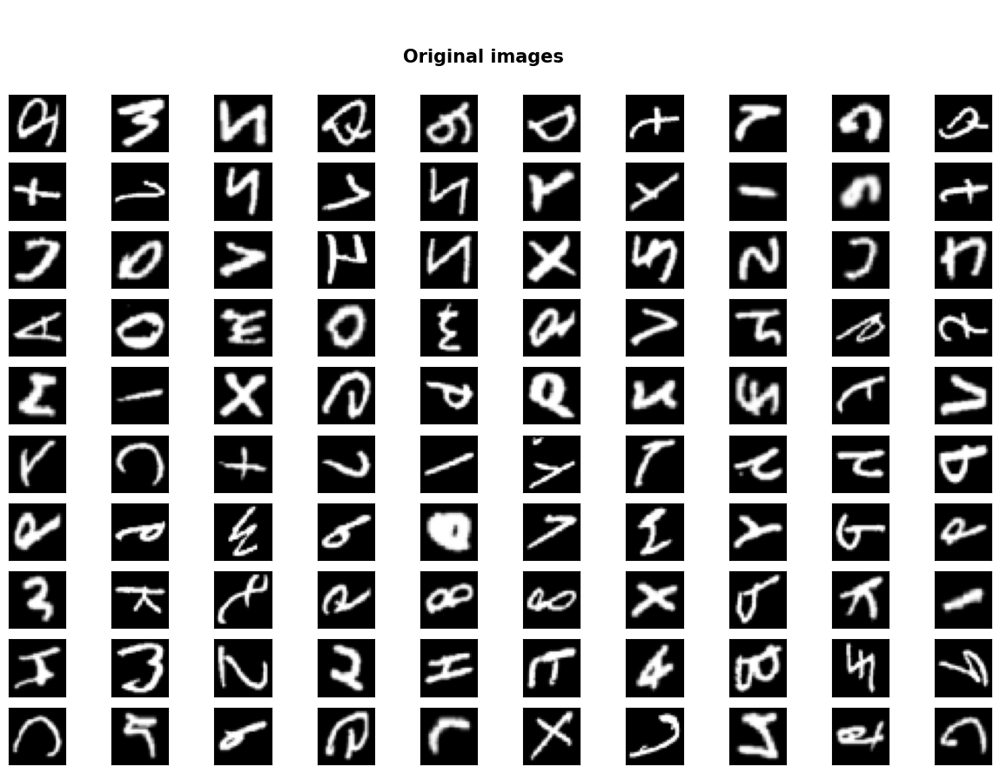

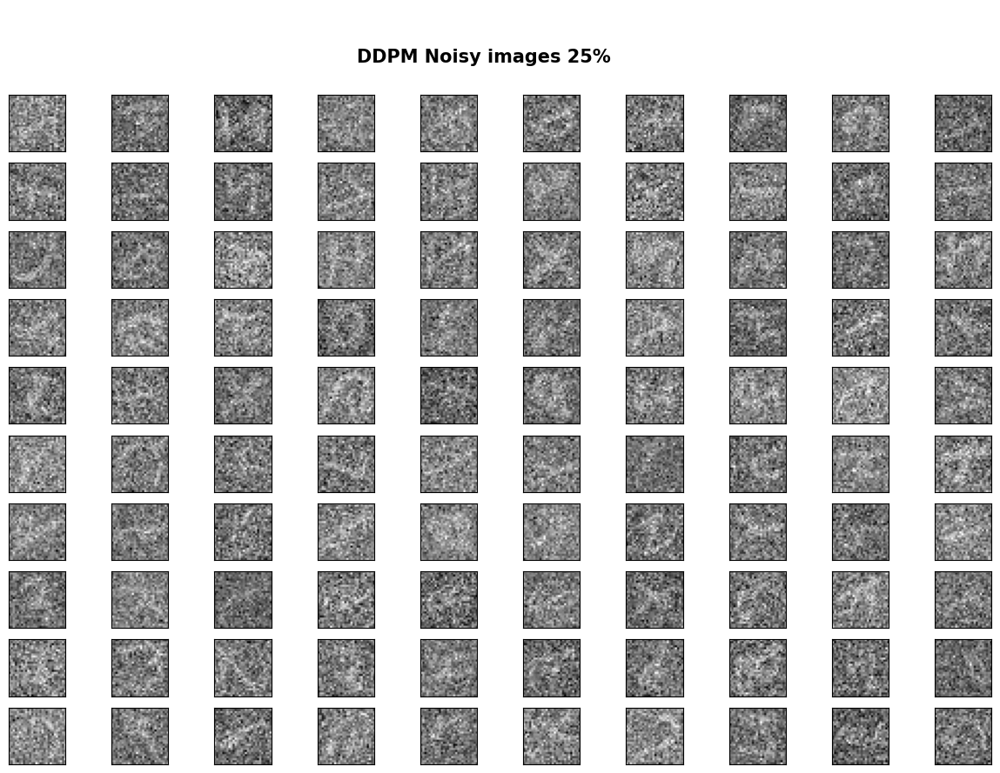

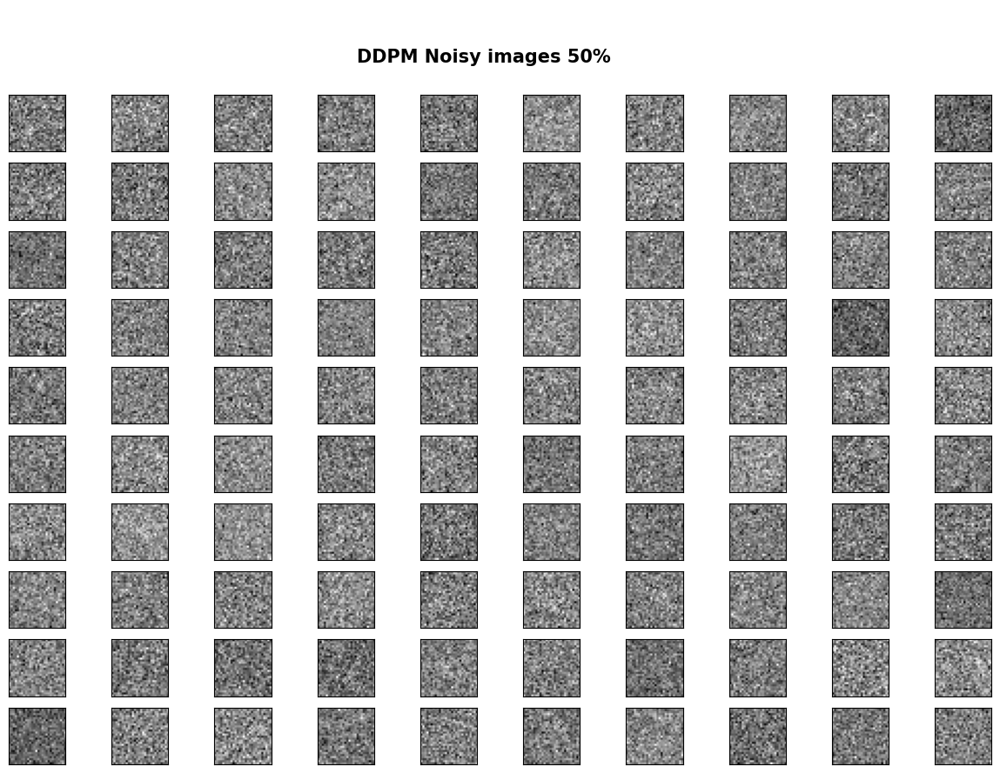

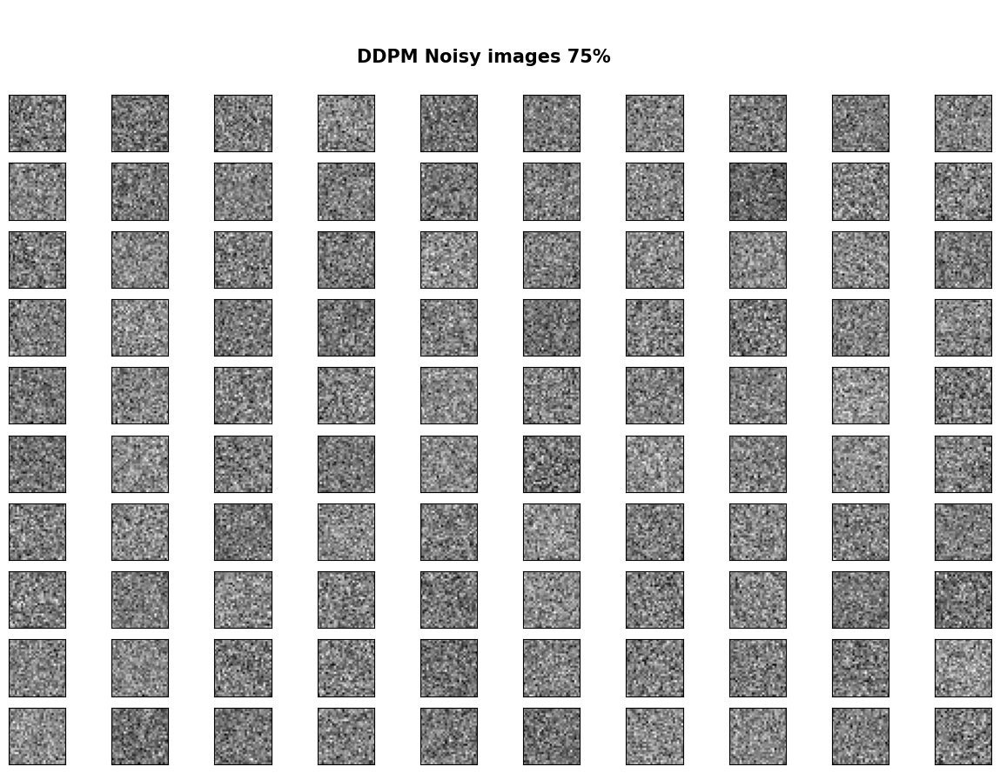

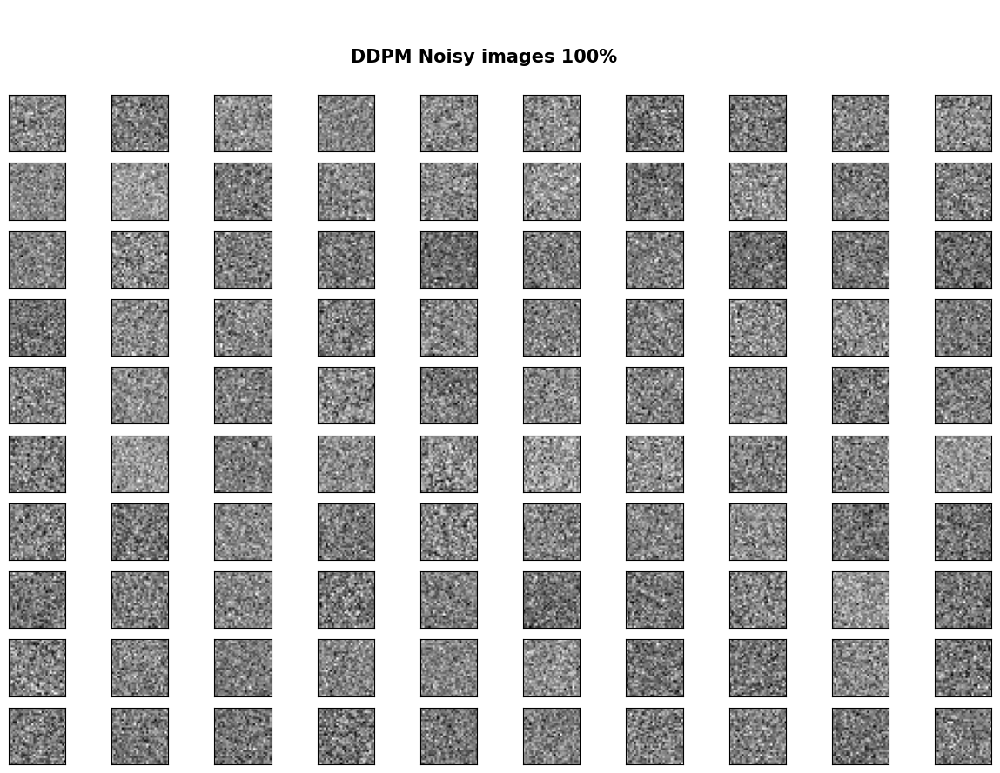

In [ ]:
show_forward(ddpm, loader, device)

# <a name=''>**Training loop**</a>

The training loop is fairly simple. With each batch of our dataset, we run the forward process on the batch. We use a different timesteps $t$ for each of the `N` images in our `(N, C, H, W)` batch tensor to guarantee more training stability. The added noise is a `(N, C, H, W)` tensor $\epsilon$.

Once we obtained the noisy images, we try to predict $\epsilon$ out of them with our network. We optimize with a simple Mean-Squared Error (MSE) loss.

In [ ]:
def training_loop(ddpm, loader, n_epochs, optim, device, display=False, store_path="ddpm_model.pt"):
    mse = nn.MSELoss()
    best_loss = float("inf")
    n_steps = ddpm.n_steps

    for epoch in tqdm(range(n_epochs), desc=f"Training progress", colour="#00ff00"):
        epoch_loss = 0.0
        for step, batch in enumerate(tqdm(loader, leave=False, desc=f"Epoch {epoch + 1}/{n_epochs}", colour="#005500")):
            # Loading data
            x0 = batch[0].to(device)
            n = len(x0)

            # Picking some noise for each of the images in the batch, a timestep and the respective alpha_bars
            eta = torch.randn_like(x0).to(device)
            t = torch.randint(0, n_steps, (n,)).to(device)

            # Computing the noisy image based on x0 and the time-step (forward process)
            noisy_imgs = ddpm(x0, t, eta)

            # Getting model estimation of noise based on the images and the time-step
            eta_theta = ddpm.backward(noisy_imgs, t.reshape(n, -1))

            # Optimizing the MSE between the noise plugged and the predicted noise
            loss = mse(eta_theta, eta)
            optim.zero_grad()
            loss.backward()
            optim.step()

            epoch_loss += loss.item() * len(x0) / len(loader.dataset)

        # Display images generated at this epoch
        if display:
            show_images(generate_new_images(ddpm, device=device), f"Images generated at epoch {epoch + 1}")

        log_string = f"Loss at epoch {epoch + 1}: {epoch_loss:.3f}"

        # Storing the model
        if best_loss > epoch_loss:
            best_loss = epoch_loss
            torch.save(ddpm.state_dict(), store_path)
            log_string += " --> Best model ever (stored)"

        print(log_string)

In [ ]:
store_path = "ddpm_fashion.pt" if fashion else "ddpm_mnist.pt"
if not no_train:
    training_loop(ddpm, loader, n_epochs, optim=Adam(ddpm.parameters(), lr), device=device, store_path=store_path)

Training progress:   0%|          | 0/30 [00:00<?, ?it/s]

Epoch 1/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 1: 0.268 --> Best model ever (stored)


Epoch 2/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 2: 0.054 --> Best model ever (stored)


Epoch 3/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 3: 0.041 --> Best model ever (stored)


Epoch 4/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 4: 0.037 --> Best model ever (stored)


Epoch 5/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 5: 0.034 --> Best model ever (stored)


Epoch 6/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 6: 0.032 --> Best model ever (stored)


Epoch 7/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 7: 0.030 --> Best model ever (stored)


Epoch 8/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 8: 0.029 --> Best model ever (stored)


Epoch 9/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 9: 0.028 --> Best model ever (stored)


Epoch 10/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 10: 0.028 --> Best model ever (stored)


Epoch 11/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 11: 0.027 --> Best model ever (stored)


Epoch 12/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 12: 0.027 --> Best model ever (stored)


Epoch 13/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 13: 0.026 --> Best model ever (stored)


Epoch 14/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 14: 0.026 --> Best model ever (stored)


Epoch 15/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 15: 0.026 --> Best model ever (stored)


Epoch 16/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 16: 0.025 --> Best model ever (stored)


Epoch 17/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 17: 0.025


Epoch 18/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 18: 0.025 --> Best model ever (stored)


Epoch 19/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 19: 0.024 --> Best model ever (stored)


Epoch 20/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 20: 0.024 --> Best model ever (stored)


Epoch 21/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 21: 0.024 --> Best model ever (stored)


Epoch 22/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 22: 0.024


Epoch 23/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 23: 0.024 --> Best model ever (stored)


Epoch 24/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 24: 0.024 --> Best model ever (stored)


Epoch 25/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 25: 0.023 --> Best model ever (stored)


Epoch 26/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 26: 0.023 --> Best model ever (stored)


Epoch 27/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 27: 0.023 --> Best model ever (stored)


Epoch 28/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 28: 0.023


Epoch 29/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 29: 0.023 --> Best model ever (stored)


Epoch 30/30:   0%|          | 0/975 [00:00<?, ?it/s]

Loss at epoch 30: 0.023


# <a name=''>**Testing the trained model**</a>

Time to check how well our model does. We re-store the best performing model according to our training loss and set it to evaluation mode. Finally, we display a batch of generated images and the relative obtained and nice GIF.

In [ ]:
# Loading the trained model
best_model = MyDDPM(MyUNet(), n_steps=n_steps, device=device)
best_model.load_state_dict(torch.load(store_path, map_location=device))
best_model.eval()
print(f'\nModel Loaded\n')


Model Loaded




Generating New Images



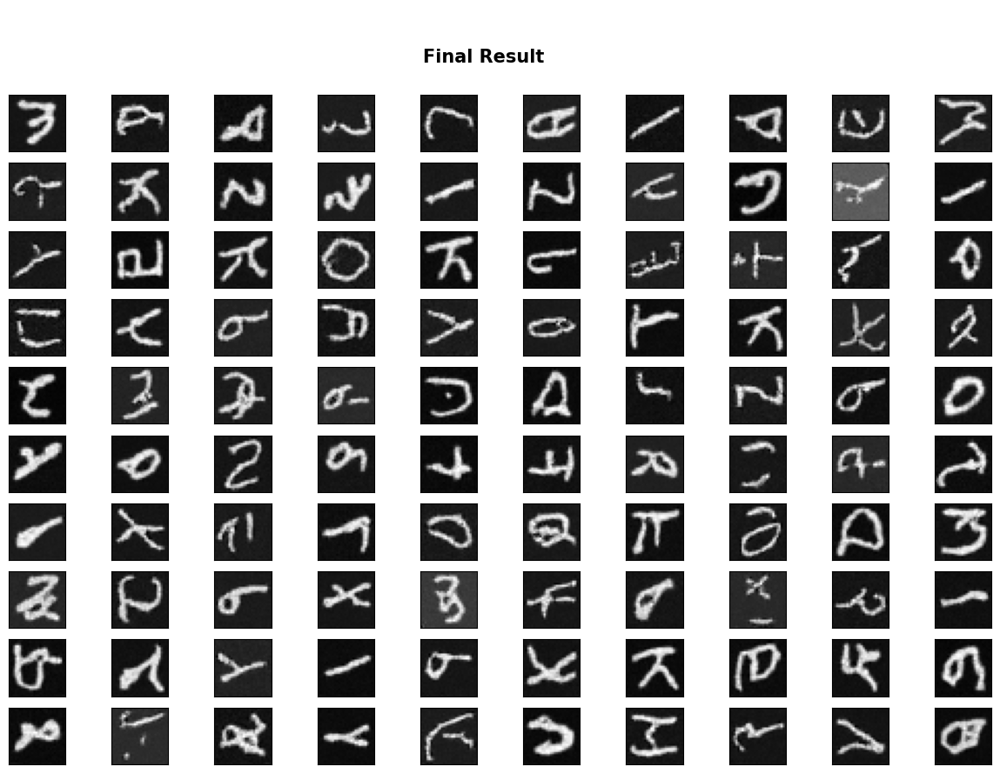

In [ ]:
print(f'\nGenerating New Images\n')
generated = generate_new_images(
        best_model,
        n_samples=100,
        device=device,
        gif_name="fashion.gif" if fashion else "mnist.gif"
    )
show_images(generated, 'Final Result')

# <a name=''>**Visualizing the diffusion Results**</a>

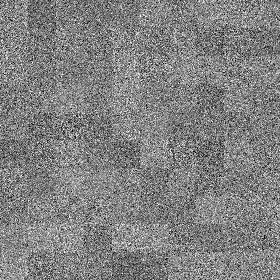

In [ ]:
from IPython.display import Image

Image(open('fashion.gif' if fashion else 'mnist.gif', 'rb').read(), width=500, height=500)